# Прокрустово преобразование

### Условие задачи

**Дано:**

- 5 датасетов: `tiny`, `small`, `medium`, `large`, `xlarge`
- каждый датасет содержит массив фигур (кривых) в трехмерном пространстве, а каждая фигура состоит из 1000 точек
- [прокрустово преобразование](https://en.wikipedia.org/wiki/Orthogonal_Procrustes_problem)
- метод главных компонент [`PCA`](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)
- метод [кластеризации](https://scikit-learn.org/stable/modules/clustering.html), например, [`k-средних`](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.k_means.html)

**Требуется:**

- выполнить описанные ниже требования для каждого датасета:
- для каждой пары фигур выполнить прокрустово преобразование и вычислить расстояние между кривыми
    - расстояние между кривыми = среднее евклидово расстояние между соответствующими точками фигур (т.е. точками с одинаковыми индексами)
- во время выполнения расчетов выводить время, затраченное на них
- построить матрицу расстояний между кривыми, где в i-й строке (и столбце) расположен вектор расстояний от i-й кривой до всех остальных
- отобразить матрицу расстояний на рисунке (график 0)
- к матрице расстояний применить метод главных компонент (`PCA`):
    - выделить 2 главных направления (компоненты), метод `fit`
    - спроецировать векторы расстояний на плоскость, заданную найденными направлениями, метод `transform`
    - на выходе будут получена матрица из двумерных векторов (`проекция`)
    - методы класса `PCA`: `fit` + `transform` или `fit_transform`
- полученную `проекцию` отобразить на рисунке (график 1)
- по графику 1 определить количество кластеров (визуально), если это требует выбранный метод кластеризации
- применить метод кластеризации к векторам `проекции`:
    - определить номер кластера для каждого вектора `проекции`, а, следовательно, для каждой фигуры
    - определить центры кластеров
- отобразить `проекцию`, центры и номера кластеров (график 2)
- для каждого кластера построить рисунок (графики 3):
    - три проекции фигур этого кластера (`x-y`, `x-z`, `y-z`)
    - фигуры отображать полупрозрачным цветом
    - см. Рис. 1
- задокументировать функции

<table>
    <td>
        <tr><img src="procrustes_cluster_example.png" width=800 /></tr>
        <tr><center>Рис. 1. Пример рисунка с проекциями фигур (график 3)</center></tr>
    </td>
</table>


**Материалы:**
- [Прокрустов анализ](https://en.wikipedia.org/wiki/Procrustes_analysis)
- [Прокрустово преобразование](https://en.wikipedia.org/wiki/Orthogonal_Procrustes_problem)
- [Метод главных компонент](https://ru.wikipedia.org/wiki/Метод_главных_компонент)
- [Методы кластеризации](https://scikit-learn.org/stable/modules/clustering.html)
- [Метод k-средних](https://ru.wikipedia.org/wiki/Метод_k-средних)


**Правила оценивания:**

- оценка за корректно выполненный расчет для каждого датасета, баллов из 100:
```
    dataset    =  tiny, small, medium, large, xlarge
    g(dataset) =   1.0,   6.2,   14.6,  28.2,   50.0
```

- штрафы $p(i)$, баллов:
    - не выведено время расчета - 20
    - не построен график 0 - 20
    - не построен график 1 - 20
    - не построен график 2 - 20
    - не построен график 3 - 30
    - нет документации функций - 20
    - менее значимые недоработки - 10


- итоговая оценка за задание = $\sum_{dataset=tiny}^{xlarge}{g(dataset)} - \sum_{i}{p(i)}$


In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from sklearn import cluster, decomposition
from numba import njit, prange
from tqdm import trange
import time

In [2]:
tiny = np.load('procrustes_problem_dataset_tiny.npy')
small = np.load('procrustes_problem_dataset_small.npy')
medium = np.load('procrustes_problem_dataset_medium.npy')
large = np.load('procrustes_problem_dataset_large.npy')
xlarge = np.load('procrustes_problem_dataset_xlarge.npy')

In [3]:
def transform(fig):
    '''
    Переносит центроид в начало координат и масштабирует
    
    Параметры
    ---------
    fig : ndarray(dtype=float, dim=2)
          Исходная фигура (матрица)
    
    Возвращаемое значение
    ---------------------
    fig : ndarray(dtype=float, dim=2)
          Измененная фигура (матрица)
    '''
    fig -= fig.mean(axis=0)
    fig /= np.sqrt(np.mean(fig**2, axis=0))
    return fig

In [4]:
@njit(fastmath=True)
def procrustes(a, b):
    '''
    Функция поворачивает одну фигуру относительно другой
    
    Параметры
    ---------
    a : ndarray(dtype=float, dim=2)
        Матрица, относительно которой производим поворот
    b : ndarray(dtype=float, dim=2)
        Матрица, которую поворачиваем
    
    Возвращаемое значение
    ---------------------
    mod_b : ndarray(dtype=float, dim=2)
            Получившаяся матрица
    '''
    M = a.T @ b
    U, D, VT = np.linalg.svd(M)
    R = U @ VT
    mod_b = b @ R.T
    return mod_b

In [5]:
@njit(fastmath=True)
def dist(a, b):
    '''
    Функция вычисляет расстояние между двумя фигурами (матрицами)
    
    Параметры
    ---------
    a : ndarray(dtype=float, dim=2)
        Фигура
    b : ndarray(dtype=float, dim=2)
        Фигура
        
    Возвращаемое значение
    ---------------------
    dist: float
          Расстояние между двумя входными фигурами (матрицами)
    '''
    return np.sqrt(np.sum((b-a)**2, axis=1)).mean()

In [6]:
@njit(parallel=True)
def dist_proc(data):
    '''
    Функция выполняет прокрустово преобразование для каждой пары фигур и вычисляет расстояние между ними
    
    Параметры
    ---------
    data : ndarray(dtype=float, dim=3)
           Массив фигур
           
    Возвращаемое значение
    ---------------------
    Dist : ndarray(dtype=float, dim=2)
           Матрица расстояний, после прокрустового преобразования
    '''
    Dist = np.empty((len(data), len(data)))
    for i in prange(len(data)):
        for j in range(len(data)):
            Dist[j, i] = dist(data[i], procrustes(data[i], data[j]))
    return Dist

In [7]:
pca = decomposition.PCA(n_components=2)
all_data = np.array([tiny, small, medium, large, xlarge])

C:\Users\rybak\AppData\Local\Temp\ipykernel_15848\3891926618.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  all_data = np.array([tiny, small, medium, large, xlarge])


In [109]:
arr = ['tiny', 'small', 'medium', 'large', 'xlarge']
for i, data in enumerate(all_data):
    start = time.time()
    for fig in trange(len(data)):
        data[fig] = transform(data[fig])
    np.save("dists_"+arr[i]+".npy", dist_proc(data))
    print("Время работы для " + arr[i] + " файла: ", time.time() - start, " секунд")

100%|██████████| 197/197 [00:00<00:00, 10884.82it/s]


Время работы для tiny файла:  0.20858407020568848  секунд


100%|██████████| 598/598 [00:00<00:00, 5450.91it/s]


Время работы для small файла:  1.8813719749450684  секунд


100%|██████████| 2398/2398 [00:00<00:00, 8394.57it/s]


Время работы для medium файла:  29.929217100143433  секунд


100%|██████████| 5994/5994 [00:00<00:00, 10777.93it/s]


Время работы для large файла:  226.51784229278564  секунд


100%|██████████| 16095/16095 [00:01<00:00, 11307.67it/s]


Время работы для xlarge файла:  1756.1108710765839  секунд


In [8]:
clusters_count = [4, 5, 4, 7, 9] # посчитали вручную далее, здесь просто для удобства собраны вместе

C:\Users\rybak\anaconda3\envs\env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\rybak\anaconda3\envs\env\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


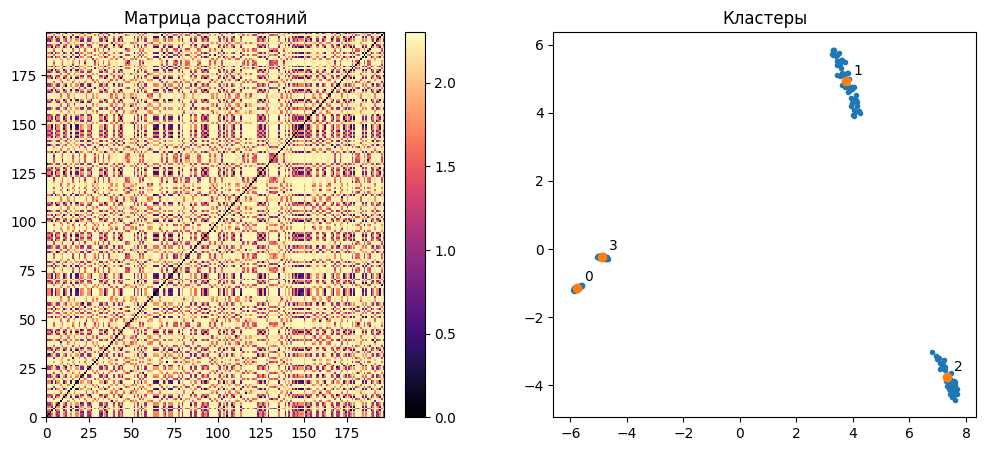

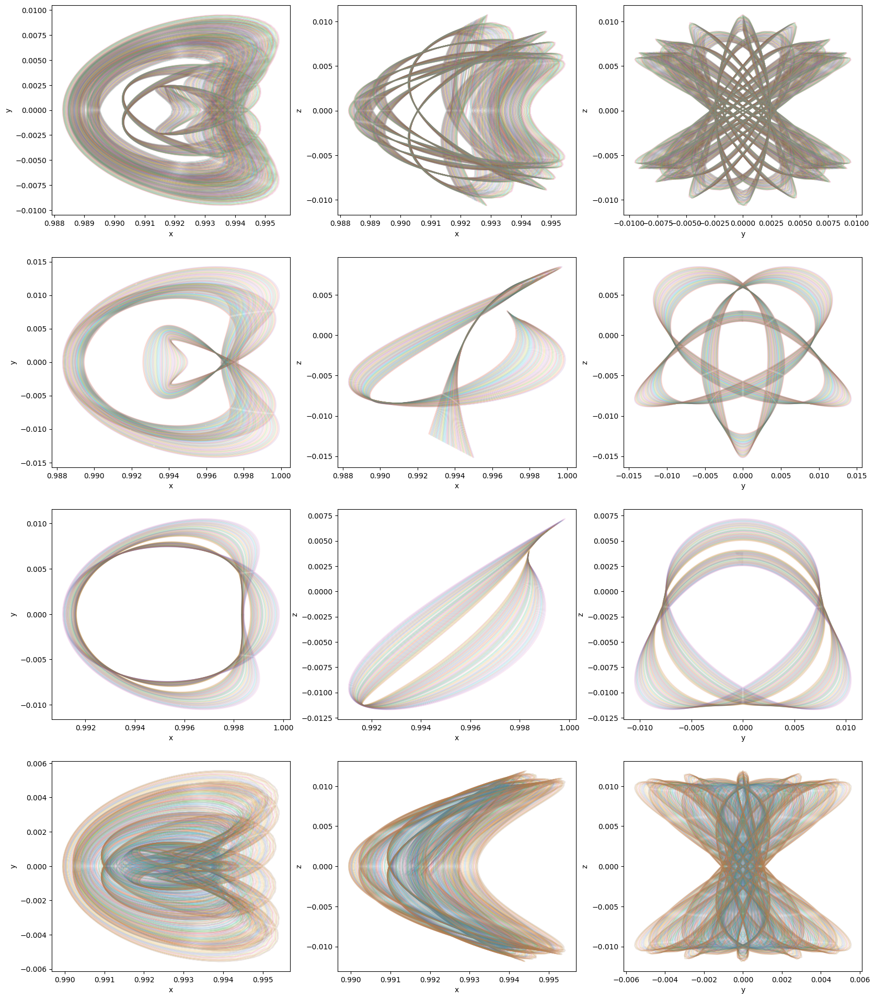

In [20]:
dists = np.load('dists_tiny.npy');

fig, axes = plt.subplots(1, 2);
fig.set_size_inches(12, 5);
axes[0].set_title('Матрица расстояний');
gr = axes[0].pcolormesh(dists, cmap='magma');
plt.colorbar(gr)

res = pca.fit_transform(dists);
axes[1].set_title('Кластеры');
axes[1].scatter(*res.T, marker='.');
centr, labels, _ = cluster.k_means(res, clusters_count[0]);
axes[1].scatter(*centr.T);
for j in range(len(centr)):
        axes[1].annotate(j, centr[j], xytext=(5, 5), textcoords='offset points');

fig, axes = plt.subplots(clusters_count[0], 3);
fig.set_size_inches(20, 6 * clusters_count[0]);
for j, shape in enumerate(tiny):
    axes[labels[j]][0].plot(*shape[:, (0, 1)].T, alpha=0.15);
    axes[labels[j]][0].set_xlabel("x");
    axes[labels[j]][0].set_ylabel("y");
    axes[labels[j]][1].plot(*shape[:, (0, 2)].T, alpha=0.15);
    axes[labels[j]][1].set_xlabel("x");
    axes[labels[j]][1].set_ylabel("z");
    axes[labels[j]][2].plot(*shape[:, (1, 2)].T, alpha=0.15);
    axes[labels[j]][2].set_xlabel("y");
    axes[labels[j]][2].set_ylabel("z");

C:\Users\rybak\anaconda3\envs\env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\rybak\anaconda3\envs\env\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


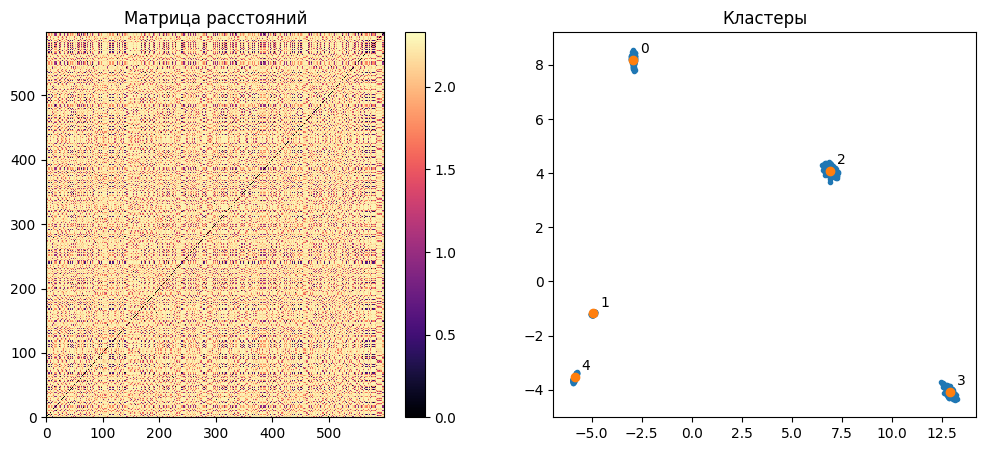

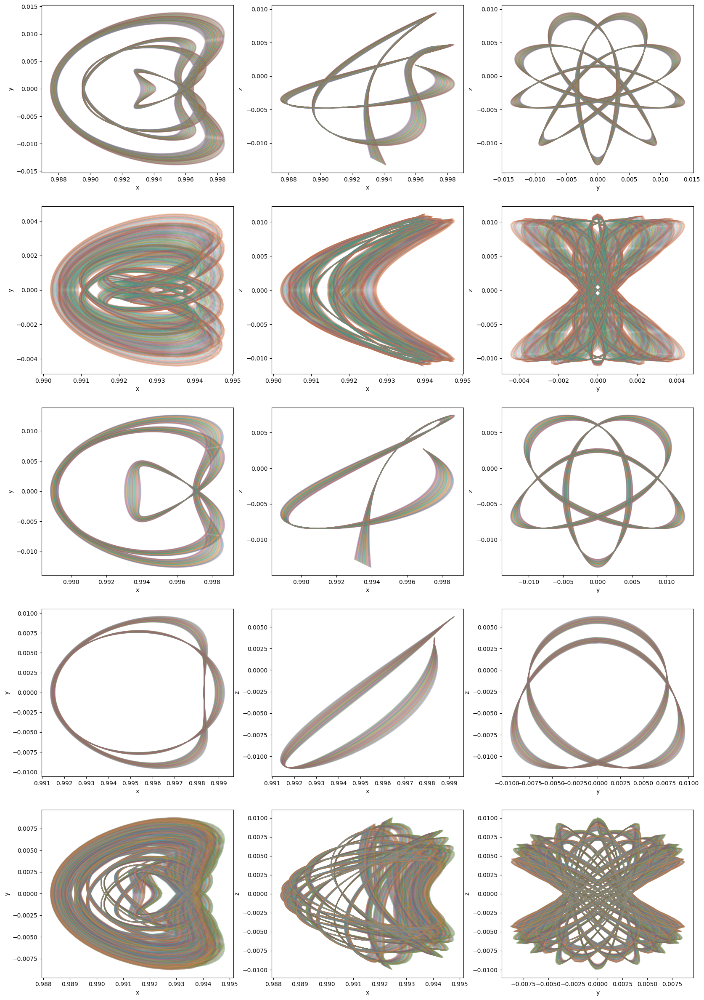

In [32]:
dists = np.load('dists_small.npy');

fig, axes = plt.subplots(1, 2);
fig.set_size_inches(12, 5);
axes[0].set_title('Матрица расстояний');
gr = axes[0].pcolormesh(dists, cmap='magma');
plt.colorbar(gr)

res = pca.fit_transform(dists);
axes[1].set_title('Кластеры');
axes[1].scatter(*res.T, marker='.');
centr, labels, _ = cluster.k_means(res, clusters_count[1]);
axes[1].scatter(*centr.T);
for j in range(len(centr)):
        axes[1].annotate(j, centr[j], xytext=(5, 5), textcoords='offset points');

fig, axes = plt.subplots(clusters_count[1], 3);
fig.set_size_inches(20, 6 * clusters_count[1]);
for j, shape in enumerate(small):
    axes[labels[j]][0].plot(*shape[:, (0, 1)].T, alpha=0.15);
    axes[labels[j]][0].set_xlabel("x");
    axes[labels[j]][0].set_ylabel("y");
    axes[labels[j]][1].plot(*shape[:, (0, 2)].T, alpha=0.15);
    axes[labels[j]][1].set_xlabel("x");
    axes[labels[j]][1].set_ylabel("z");
    axes[labels[j]][2].plot(*shape[:, (1, 2)].T, alpha=0.15);
    axes[labels[j]][2].set_xlabel("y");
    axes[labels[j]][2].set_ylabel("z");

C:\Users\rybak\anaconda3\envs\env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\rybak\anaconda3\envs\env\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=10.
  warnings.warn(


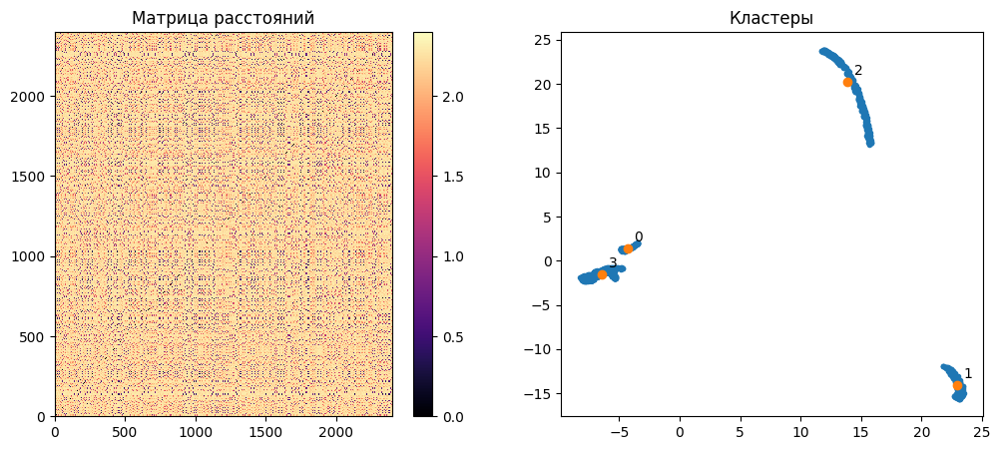

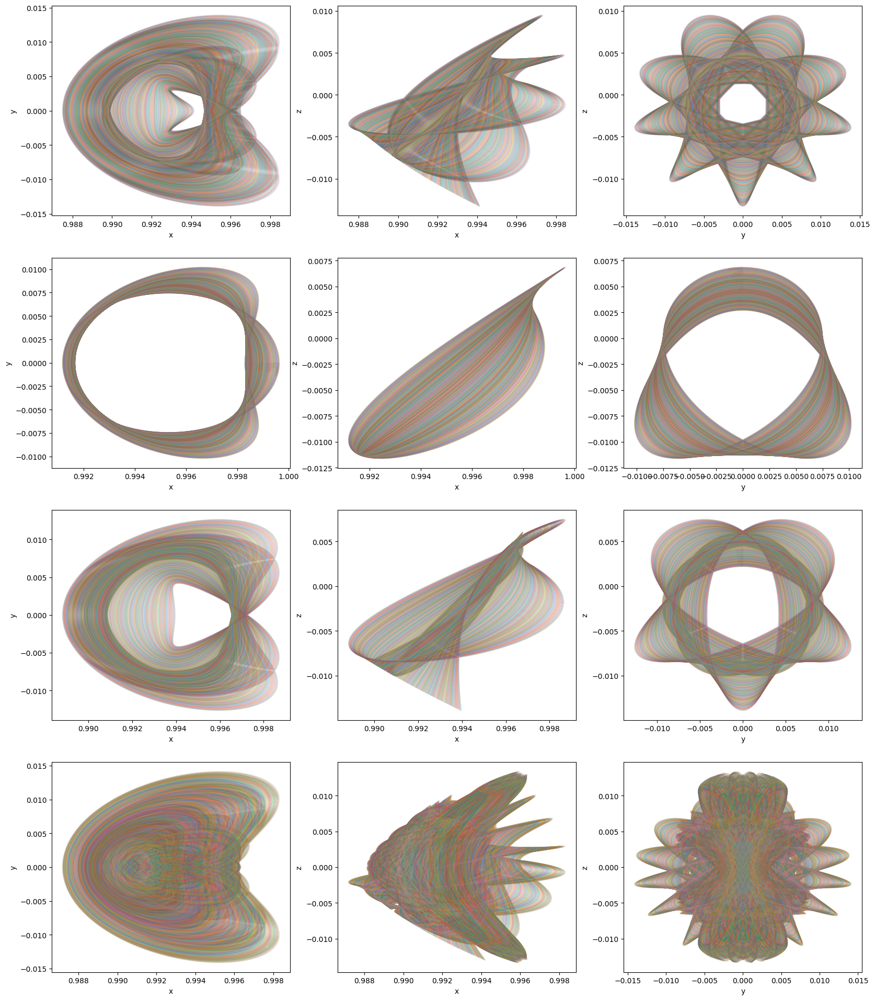

In [33]:
dists = np.load('dists_medium.npy');

fig, axes = plt.subplots(1, 2);
fig.set_size_inches(12, 5);
axes[0].set_title('Матрица расстояний');
gr = axes[0].pcolormesh(dists, cmap='magma');
plt.colorbar(gr)

res = pca.fit_transform(dists);
axes[1].set_title('Кластеры');
axes[1].scatter(*res.T, marker='.');
centr, labels, _ = cluster.k_means(res, clusters_count[2]);
axes[1].scatter(*centr.T);
for j in range(len(centr)):
        axes[1].annotate(j, centr[j], xytext=(5, 5), textcoords='offset points');

fig, axes = plt.subplots(clusters_count[2], 3);
fig.set_size_inches(20, 6 * clusters_count[2]);
for j, shape in enumerate(medium):
    axes[labels[j]][0].plot(*shape[:, (0, 1)].T, alpha=0.15);
    axes[labels[j]][0].set_xlabel("x");
    axes[labels[j]][0].set_ylabel("y");
    axes[labels[j]][1].plot(*shape[:, (0, 2)].T, alpha=0.15);
    axes[labels[j]][1].set_xlabel("x");
    axes[labels[j]][1].set_ylabel("z");
    axes[labels[j]][2].plot(*shape[:, (1, 2)].T, alpha=0.15);
    axes[labels[j]][2].set_xlabel("y");
    axes[labels[j]][2].set_ylabel("z");

C:\Users\rybak\anaconda3\envs\env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


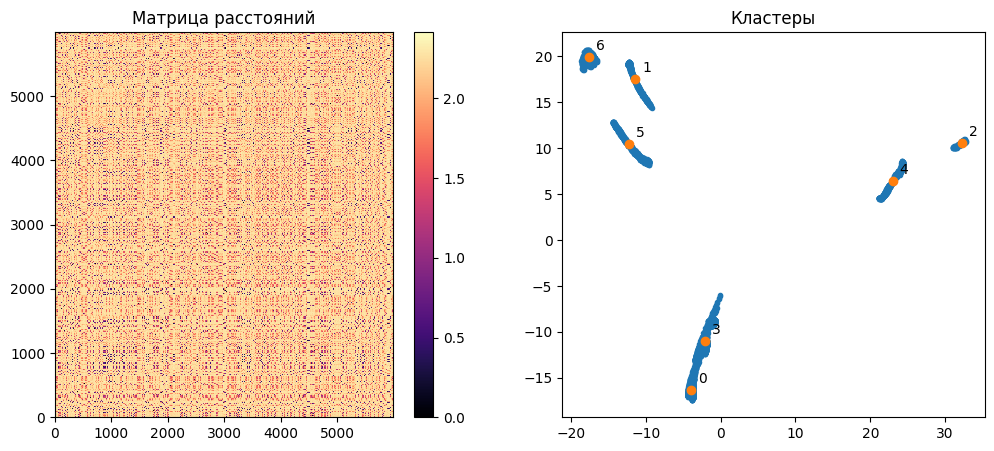

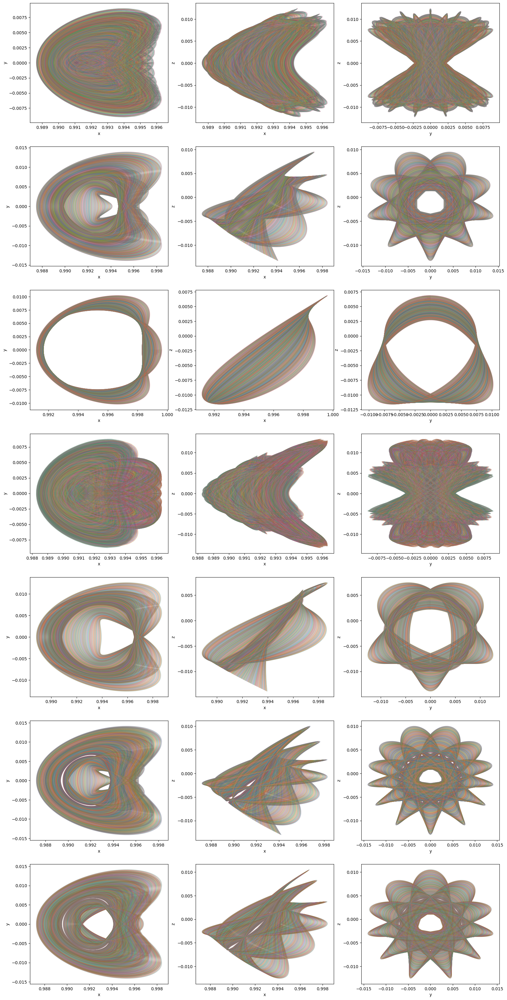

In [34]:
dists = np.load('dists_large.npy');

fig, axes = plt.subplots(1, 2);
fig.set_size_inches(12, 5);
axes[0].set_title('Матрица расстояний');
gr = axes[0].pcolormesh(dists, cmap='magma');
plt.colorbar(gr)

res = pca.fit_transform(dists);
axes[1].set_title('Кластеры');
axes[1].scatter(*res.T, marker='.');
centr, labels, _ = cluster.k_means(res, clusters_count[3]);
axes[1].scatter(*centr.T);
for j in range(len(centr)):
        axes[1].annotate(j, centr[j], xytext=(5, 5), textcoords='offset points');

fig, axes = plt.subplots(clusters_count[3], 3);
fig.set_size_inches(20, 6 * clusters_count[3]);
for j, shape in enumerate(large):
    axes[labels[j]][0].plot(*shape[:, (0, 1)].T, alpha=0.1);
    axes[labels[j]][0].set_xlabel("x");
    axes[labels[j]][0].set_ylabel("y");
    axes[labels[j]][1].plot(*shape[:, (0, 2)].T, alpha=0.1);
    axes[labels[j]][1].set_xlabel("x");
    axes[labels[j]][1].set_ylabel("z");
    axes[labels[j]][2].plot(*shape[:, (1, 2)].T, alpha=0.1);
    axes[labels[j]][2].set_xlabel("y");
    axes[labels[j]][2].set_ylabel("z");

C:\Users\rybak\anaconda3\envs\env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


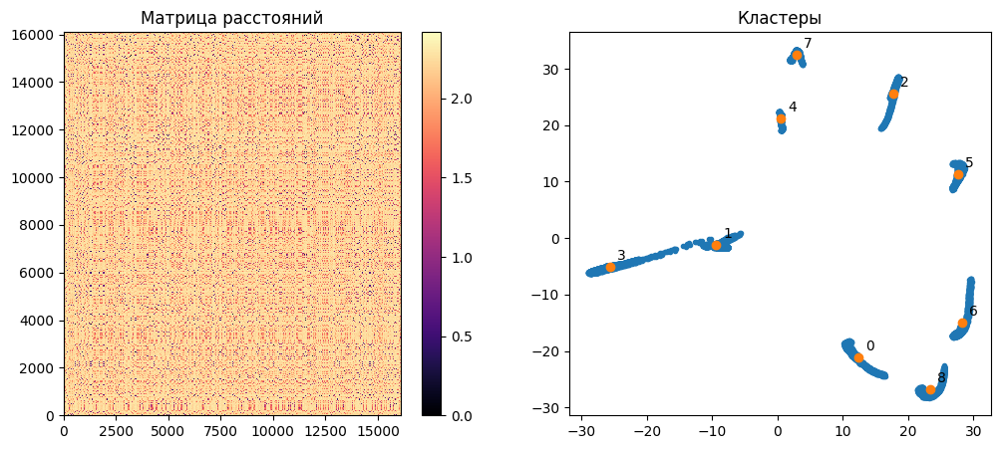

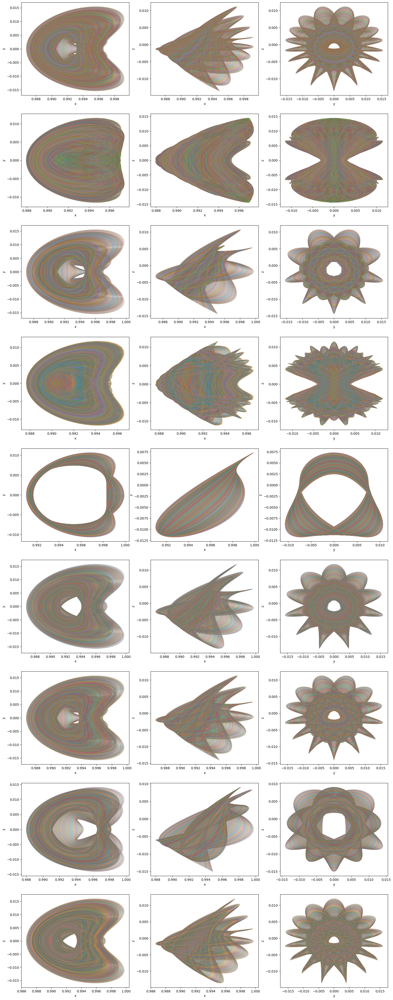

In [35]:
dists = np.load('dists_xlarge.npy');

fig, axes = plt.subplots(1, 2);
fig.set_size_inches(12, 5);
axes[0].set_title('Матрица расстояний');
gr = axes[0].pcolormesh(dists, cmap='magma');
plt.colorbar(gr)

res = pca.fit_transform(dists);
axes[1].set_title('Кластеры');
axes[1].scatter(*res.T, marker='.');
centr, labels, _ = cluster.k_means(res, clusters_count[4]);
axes[1].scatter(*centr.T);
for j in range(len(centr)):
        axes[1].annotate(j, centr[j], xytext=(5, 5), textcoords='offset points');

fig, axes = plt.subplots(clusters_count[4], 3);
fig.set_size_inches(20, 6 * clusters_count[4]);
for j, shape in enumerate(xlarge):
    axes[labels[j]][0].plot(*shape[:, (0, 1)].T, alpha=0.1);
    axes[labels[j]][0].set_xlabel("x");
    axes[labels[j]][0].set_ylabel("y");
    axes[labels[j]][1].plot(*shape[:, (0, 2)].T, alpha=0.1);
    axes[labels[j]][1].set_xlabel("x");
    axes[labels[j]][1].set_ylabel("z");
    axes[labels[j]][2].plot(*shape[:, (1, 2)].T, alpha=0.1);
    axes[labels[j]][2].set_xlabel("y");
    axes[labels[j]][2].set_ylabel("z");